Note that to run this tutorial, you'll need to install the `mayavi` python package. See the instruction on how to install it [here](https://docs.enthought.com/mayavi/mayavi/installation.html)

# Map API

To access our map API, simply create an `ArgoverseMap`

In [1]:
tracking_dataset_dir = '../argoverse-tracking/sample/'

In [2]:
# tracking_dataset_dir = 'argoverse-tracking/sample/'

from argoverse.map_representation.map_api import ArgoverseMap

am = ArgoverseMap()

## Lane Polygon

`ArgoverseMap.find_local_lane_polygons` can be used to retrieve polygon of lanes in the specified area. 

As an example, we will get a city coordinate of the car from log 0, frame 10, and show the first 5 lane polygons within 60 meters around the cars.

In [3]:
from argoverse.data_loading.argoverse_tracking_loader import ArgoverseTrackingLoader

log_index = 0
frame_index = 100
idx = 100
argoverse_loader = ArgoverseTrackingLoader(tracking_dataset_dir)
log_id = argoverse_loader.log_list[log_index]
argoverse_data = argoverse_loader[log_index]
city_name = argoverse_data.city_name

lidar_pts = argoverse_data.get_lidar(idx)

In [4]:
city_name

'PIT'

In [5]:
"""
The coordinate used in `ArgoverseMap` is a city coordinate, while the 
annotation in `Argoverse-Tracking` dataset is in egovehicle coordinate. 

These `egovehicle` can be converted to city coodinate using pose information 
available in the dataset. 
"""
x,y,_ = argoverse_data.get_pose(frame_index).translation

In [6]:
print(x,y,_)

2599.5505965123866 1209.0214763629717 15.729643025650967


---------------------------------------------
------Example of getting lane polygon--------
---------------------------------------------


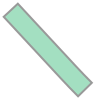

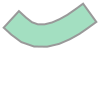

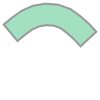

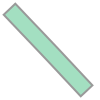

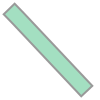

In [7]:
from shapely.geometry.polygon import Polygon
print('---------------------------------------------')
print('------Example of getting lane polygon--------')
print('---------------------------------------------')
for i in range(5):
    #Use the corresponding city name with log id
    display(Polygon(am.find_local_lane_polygons([x-30, x+30, y-30, y+30], 'PIT')[i])) 

## Driveable Area

Driveable area can also be queried in the same way,

--------------------------------------------------------
------Example of getting region of driveable area--------
--------------------------------------------------------


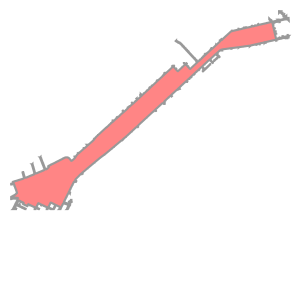

In [8]:
print('--------------------------------------------------------')
print('------Example of getting region of driveable area--------')
print('--------------------------------------------------------')
display(Polygon(am.find_local_driveable_areas([x-3, x+3, y-3, y+3], 'PIT')[0]))

# Visualize data on the map

Here we will visualize data from `Argoverse-Tracking` dataset on top of our map information. 

In [4]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
from demo_usage.visualize_30hz_benchmark_data_on_map import DatasetOnMapVisualizer
idx = 0

# Map from a bird's-eye-view (BEV)
dataset_dir = tracking_dataset_dir
experiment_prefix = 'visualization_demo'

#if you are running for the first time, or using a new set of logs, this will need to be set False to accumelate the labels again
use_existing_files = True

city_to_egovehicle_se3 = argoverse_data.get_pose(idx)

import logging
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)

domv = DatasetOnMapVisualizer(dataset_dir, experiment_prefix, use_existing_files=use_existing_files, log_id=argoverse_data.current_log)


One example is to overlay our label annotations on top of our map information. Here the pink area denotes the `driveable area`

[[[200 206 238]
  [200 206 238]
  [198 207 238]
  ...
  [185 195 222]
  [185 195 222]
  [186 196 223]]

 [[198 207 238]
  [198 207 238]
  [198 207 238]
  ...
  [186 196 223]
  [186 196 223]
  [186 196 223]]

 [[199 208 239]
  [199 208 239]
  [199 208 239]
  ...
  [186 195 224]
  [186 196 223]
  [187 197 224]]

 ...

 [[ 81  86  92]
  [ 80  85  91]
  [ 80  83  90]
  ...
  [ 94  98 107]
  [ 93  97 106]
  [ 90  94 103]]

 [[ 81  86  92]
  [ 80  85  91]
  [ 80  85  91]
  ...
  [ 93  97 106]
  [ 92  96 105]
  [ 91  95 104]]

 [[ 84  89  95]
  [ 83  88  94]
  [ 83  88  94]
  ...
  [ 90  94 103]
  [ 90  94 103]
  [ 91  95 104]]]


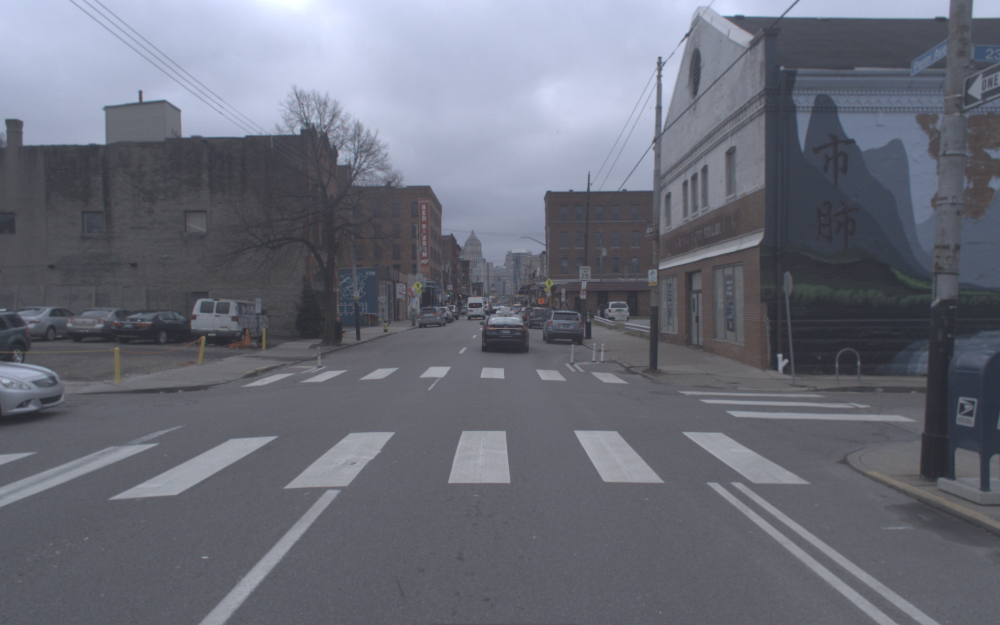

time taken: 11.532554388046265


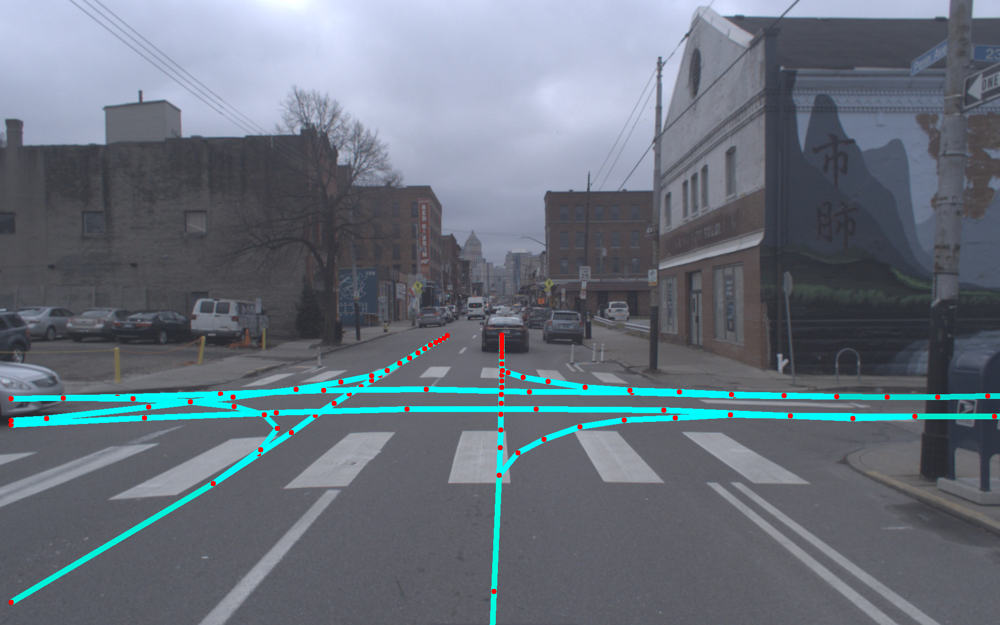

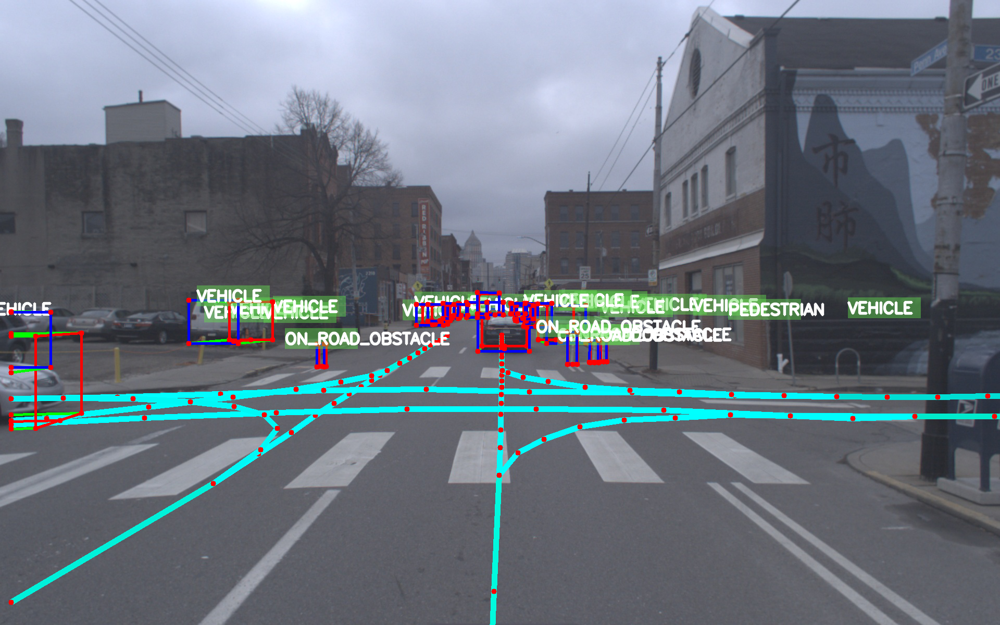

In [5]:
import argoverse.visualization.visualization_utils as viz_util
from argoverse.utils.frustum_clipping import generate_frustum_planes
from PIL import Image 
from demo_usage.cuboids_to_bboxes import plot_lane_centerlines_in_img
import time
camera = 'ring_front_center'
img = argoverse_data.get_image_sync(idx,camera = camera)
display(Image.fromarray(img))
objects = argoverse_data.get_label_object(idx)
calib = argoverse_data.get_calibration(camera)

lidar_pts = argoverse_data.get_lidar(idx)
calib = argoverse_data.get_calibration(camera=camera)
planes = generate_frustum_planes(calib.camera_config.intrinsic.copy(), camera)

start = time.time()
img_wlane, lanes, lanes_bird = plot_lane_centerlines_in_img(lidar_pts, city_to_egovehicle_se3, img, city_name, am, calib.camera_config, planes)
print("time taken:", time.time()-start)
display(Image.fromarray(img_wlane))
img_vis = viz_util.show_image_with_boxes(img_wlane,objects,calib)
display(Image.fromarray(img_vis))
# display(Image.fromarray(img_wlane))

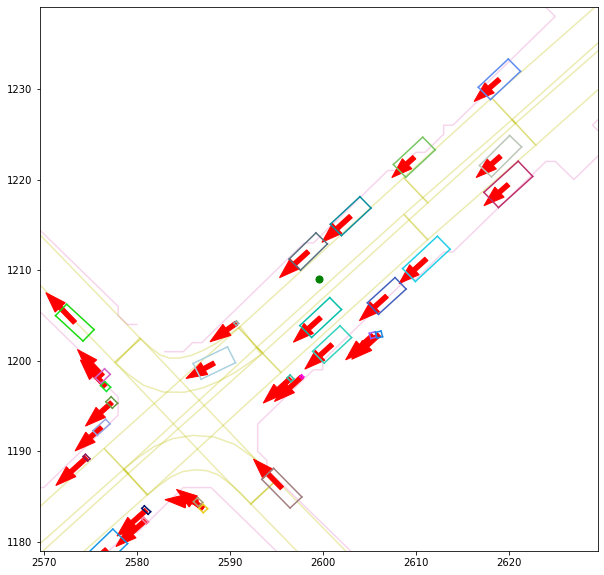

In [10]:
import copy
from argoverse.utils.mpl_plotting_utils import draw_lane_polygons, plot_bbox_2D

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)
# idx = 100
xcenter,ycenter,_ = argoverse_data.get_pose(idx).translation
    
xmin = xcenter - 30  # 150
xmax = xcenter + 30 # 150
ymin = ycenter - 30 # 150
ymax = ycenter + 30 # 150
ax.scatter(xcenter, ycenter, 200, color="g", marker=".", zorder=2)
ax.set_xlim([xmin, xmax])
ax.set_ylim([ymin, ymax])
local_lane_polygons = am.find_local_lane_polygons([xmin, xmax, ymin, ymax], city_name)

local_das = am.find_local_driveable_areas([xmin, xmax, ymin, ymax], city_name)
# for p in local_das:
#     display(Polygon(p))

domv.render_bev_labels_mpl(
    city_name,
    ax,
    "city_axis",
    None,
    copy.deepcopy(local_lane_polygons),
    copy.deepcopy(local_das),
    log_id,
    argoverse_data.lidar_timestamp_list[idx],
    city_to_egovehicle_se3,
    am,
)

# draw_lane_polygons(ax, local_lane_polygons)
# draw_lane_polygons(ax, local_das, color="tab:pink")

local_lane_centerlines = am.find_local_lane_centerlines(xcenter, ycenter, city_name="PIT")
# draw_lane_polygons(ax, local_lane_centerlines)

Similarly, we can also plot map info on top of lidar point clouds.

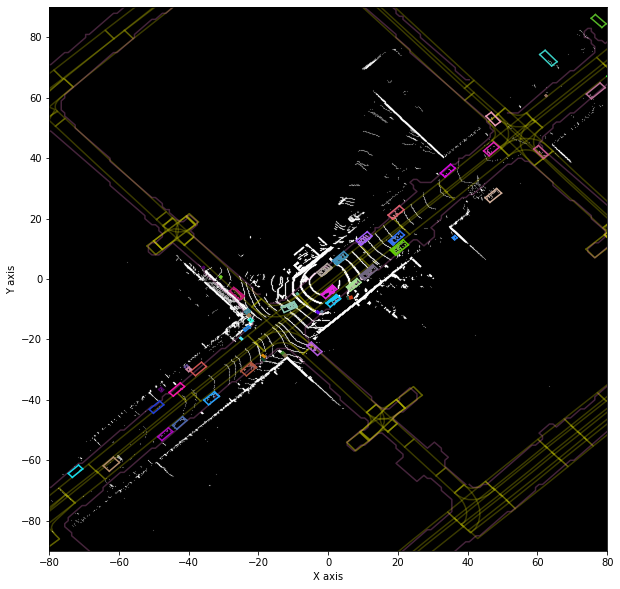

In [11]:
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111)

xcenter,ycenter,_ = argoverse_data.get_pose(idx).translation
    
xmin = xcenter - 80  # 150
xmax = xcenter + 80  # 150
ymin = ycenter - 80  # 150
ymax = ycenter + 80  # 150

ax.scatter(xcenter, ycenter, 200, color="g", marker=".", zorder=2)
ax.set_xlim([xmin, xmax])
ax.set_ylim([ymin, ymax])
domv.render_bev_labels_mpl(
    city_name,
    ax,
    "ego_axis",
    lidar_pts,
    copy.deepcopy(local_lane_polygons),
    copy.deepcopy(local_das),
    log_id,
    argoverse_data.lidar_timestamp_list[idx],
    city_to_egovehicle_se3,
    am,
)

## Removing points

In many cases, we are only intersted in points that belong to the objects of interest (e.g. cars on the road).

We can filter out any points that lie outside of the driveable area, by simply using `ArgoverseMap.remove_non_driveable_area_points`

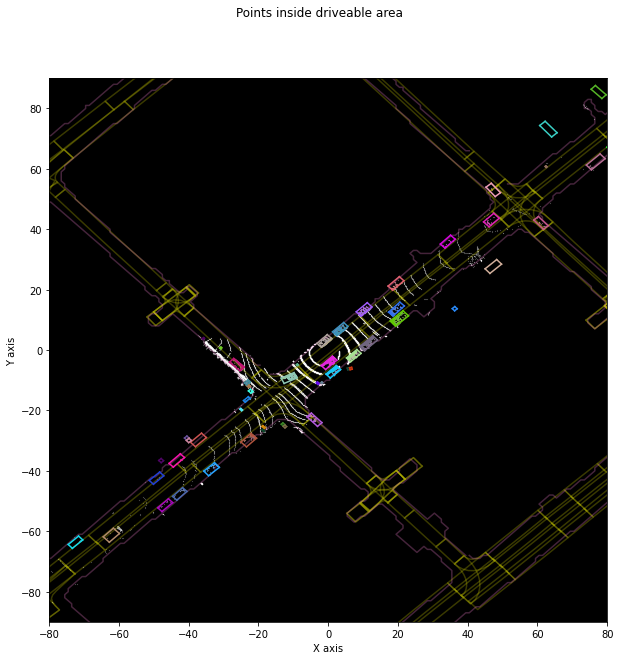

In [12]:
fig = plt.figure(figsize=(10,10))
fig.suptitle('Points inside driveable area')
ax = fig.add_subplot(111)

driveable_area_pts = copy.deepcopy(lidar_pts)
driveable_area_pts = city_to_egovehicle_se3.transform_point_cloud(
    driveable_area_pts
)  # put into city coords
driveable_area_pts = am.remove_non_driveable_area_points(driveable_area_pts, city_name)
driveable_area_pts = city_to_egovehicle_se3.inverse_transform_point_cloud(
    driveable_area_pts
)

domv.render_bev_labels_mpl(
    city_name,
    ax,
    "ego_axis",
    driveable_area_pts,
    copy.deepcopy(local_lane_polygons),
    copy.deepcopy(local_das),
    log_id,
    argoverse_data.lidar_timestamp_list[idx],
    city_to_egovehicle_se3,
    am,
)


Additionally, we can remove points that belong to the ground surface by using `Argoverse.remove_ground_surface`.

This leaves us with points that belong to objects inside the driveable area, which are shown as colored points.

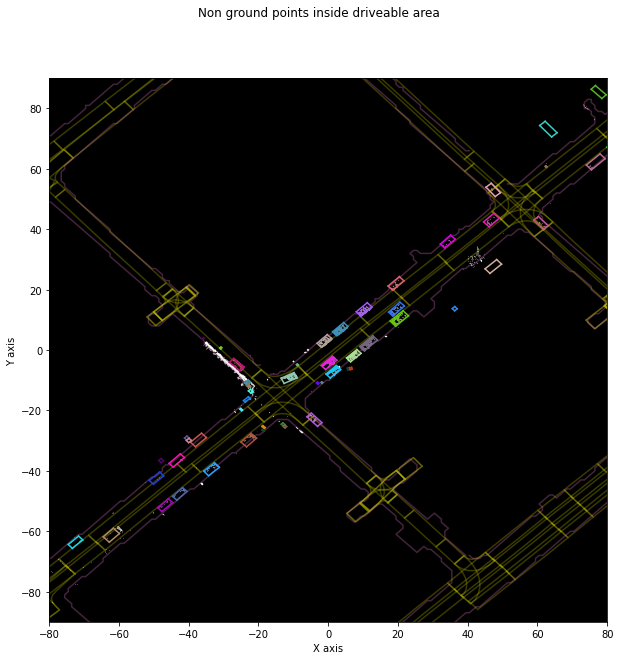

In [13]:
fig = plt.figure(figsize=(10,10))
fig.suptitle('Non ground points inside driveable area')
ax = fig.add_subplot(111)

driveable_area_pts = copy.deepcopy(lidar_pts)
driveable_area_pts = city_to_egovehicle_se3.transform_point_cloud(
    driveable_area_pts
)  # put into city coords
driveable_area_pts = am.remove_non_driveable_area_points(driveable_area_pts, city_name)
driveable_area_pts = am.remove_ground_surface(driveable_area_pts, city_name)
driveable_area_pts = city_to_egovehicle_se3.inverse_transform_point_cloud(
    driveable_area_pts
)

domv.render_bev_labels_mpl(
    city_name,
    ax,
    "ego_axis",
    driveable_area_pts,
    copy.deepcopy(local_lane_polygons),
    copy.deepcopy(local_das),
    log_id,
    argoverse_data.lidar_timestamp_list[idx],
    city_to_egovehicle_se3,
    am,
)

We can also overlay them on images from our camera sensors.

In [22]:
from demo_usage.curve_parameterization import *

In [55]:
lanes_bird_vis = []
for i in range(len(lanes)):
    lanes_bird_vis.append([])
    if lanes[i] == []:
        continue
    l = lanes_bird[i]
    for p in lanes[i]:
        lanes_bird_vis[i].append(np.array([l[p[1]][0], l[p[1]][1]]))
    # lanes_bird_vis[i] = np.array(lanes_bird_vis[i])
    # print(lanes_bird_vis[i].shape)




In [88]:
# lane_lcqs = np.array(lane_lcqs)
# lane_lcqs.T.shape
np.mean(lanes_bird[0].T[2])

15.644969940185547

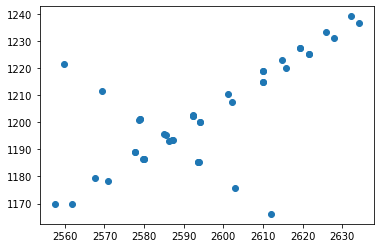

[[2593.62432036 1185.48988193   15.64496994]
 [2586.26896923 1193.25195872   15.64496994]
 [2579.03383964 1201.13454617   15.64496994]]


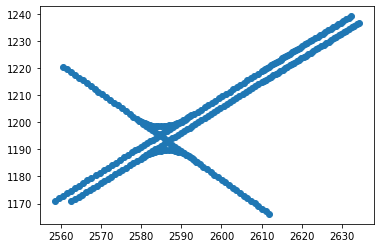

In [93]:
xs = []
ys = []
lane_lcqs = []
for lane in lanes_bird:
    h = np.mean(lane.T[2])
    num_ctrl_pts = 3
    hs = np.ones((num_ctrl_pts,1))*h
    lane_out = lsq_control_points(lane.T[:2],3)
    lane_lcqs.append(np.concatenate((lane_out, hs), axis=1))
    for p in lane_out:
        xs.append(p[0])
        ys.append(p[1])
plt.scatter(xs,ys)
plt.show()
xs = []
ys = []
for lane in lane_lcqs:
    generated = generate_bezier(lane.T[:2], 20)

    for p in generated.T:
        xs.append(p[0])
        ys.append(p[1])
plt.scatter(xs,ys)

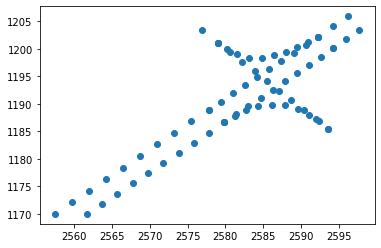

In [19]:
plt.scatter(xs,ys)

In [36]:
lane = lanes[2]
lane_input = []
for x in lane:
    lane_input.append(x[0])
lane_input = np.array(lane_input)
lane_input

array([[ 21., 735.],
       [109., 735.],
       [251., 732.],
       [394., 727.],
       [531., 717.],
       [643., 706.],
       [726., 697.],
       [775., 691.],
       [800., 685.],
       [816., 680.]])

In [38]:
for p in lane_out:
    cv2.circle(img_wlane, (int(p[0]), int(p[1])), radius=5, color=(0,0,255), thickness=-1)

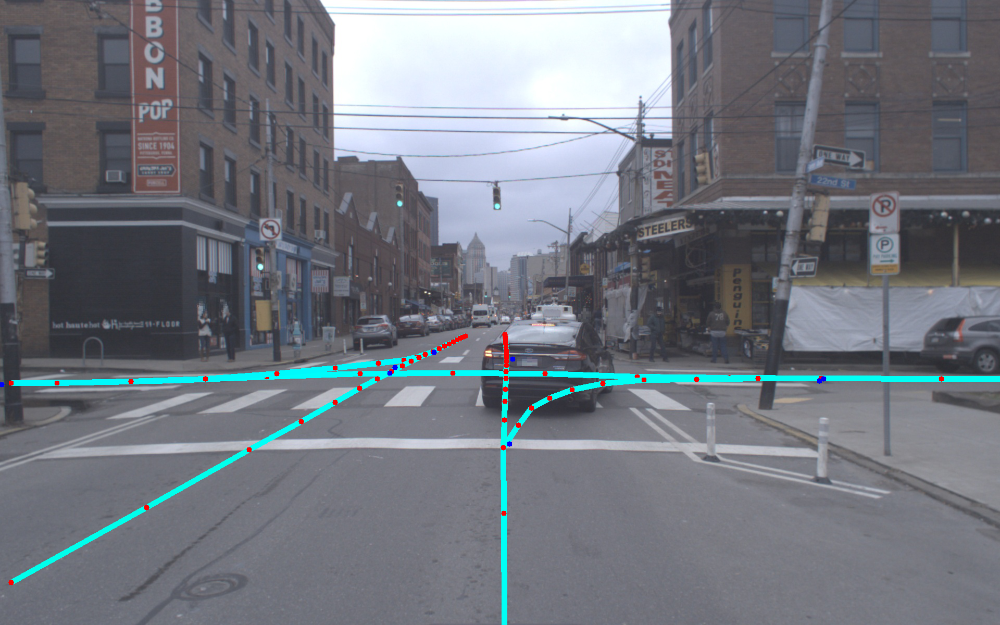

In [39]:
display(Image.fromarray(img_wlane))

In [4]:
data = {
    "info": {
    "description": "Argoverse test dataset",
    "url": "N/AS",
    "version": "0.0",
    "year": 2022,
    "contributor": "AVL",
    "date_created": "2022/01"
},
"licenses": [
    {
        "url": "http://creativecommons.org/licenses/by-nc-sa/2.0/",
        "id": 1,
        "name": "Attribution-NonCommercial-ShareAlike License"
    }
],
"images": [],

"annotations": [],

"categories": [
    {
        "supercategory": "lane",
        "id": 1,
        "name": "lane control points",
        "keypoints": [
            "head", "2", "3","4","5","6","7","8","9", "tail"
        ],
        "skeleton": [
            [1,2],[2,3],[3,4],[4,5],[5,6],[6,7],[7,8],[8,9],[9,10]
        ]
    }
]

}

In [33]:
lane_ann = []
id = 0
num_ctrl_pts = 3
for lane in lanes:
    id+=1
    if lane==[]:
        continue
    dic = {
        "segmentation": [[]],
        "num_keypoints": len(lane),
        "area": 0,
        "iscrowd": 0,
        "keypoints": [],
        "image_id": 0,
        "bbox": [],
        "category_id": 1,
        "id": id
    }
    keypoints = []
    
    p = 0
    for c in range(num_ctrl_pts):
        l = lane[p]
        if l[1] != c:
            for i in range(3):
                keypoints.append(0)
        else:
            keypoints.append(l[0][0])
            keypoints.append(l[0][1])
            keypoints.append(2)
            if p<len(lane)-1:
                p+=1
    
    
    dic["keypoints"] = keypoints
    
    lane_ann.append(dic)


In [38]:
data["annotations"] = lane_ann

In [14]:
""" import json
data = {}
data["id"] = 1
data["filename"] = ""
data["annotation"] = {}
lanes_ann = []
idx = 0
for lane in lanes:
    if lane == []:
        continue
    lane_dic = {}
    lane_dic["idx"] = idx
    idx+=1
    lane_dic["keypoints"] = {}
    keypoint_names = ["head", "center", "tail"]
    for p in lane:
        x = int(p[0][0])
        y = int(p[0][1])
        lane_dic["keypoints"][keypoint_names[p[1]]] = [x,y]
    
    lanes_ann.append(lane_dic)

data["annotation"]["lanes"] = lanes_ann

"""

    

In [7]:
import json
with open("../coco_format_sample_multicamera_keyp10.json","w") as write_file:
    json.dump(data, write_file)

time taken for camera  ring_front_center :  10.546022653579712


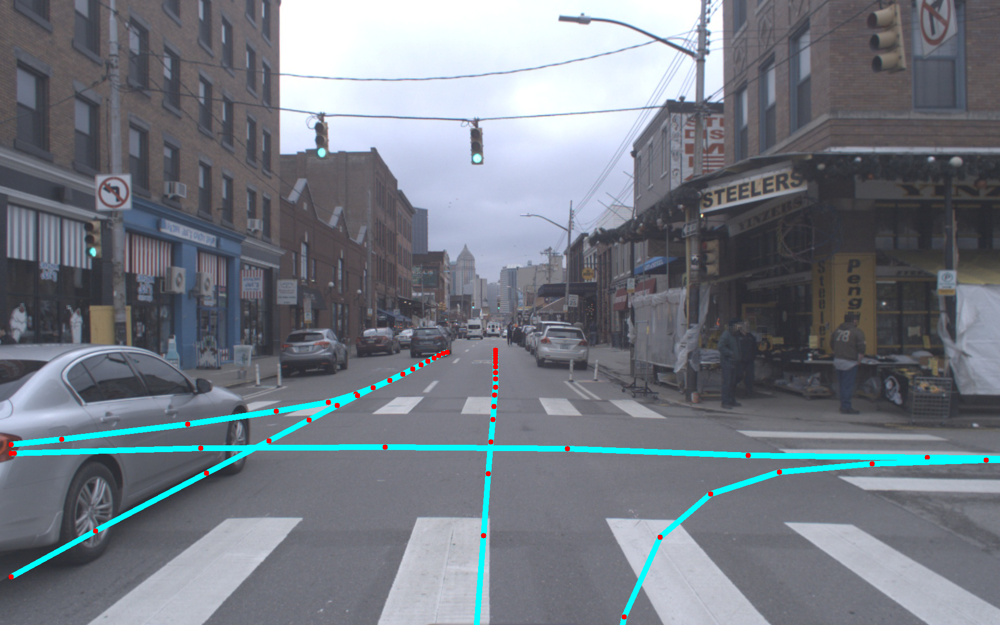

time taken for camera  ring_front_right :  12.04792594909668


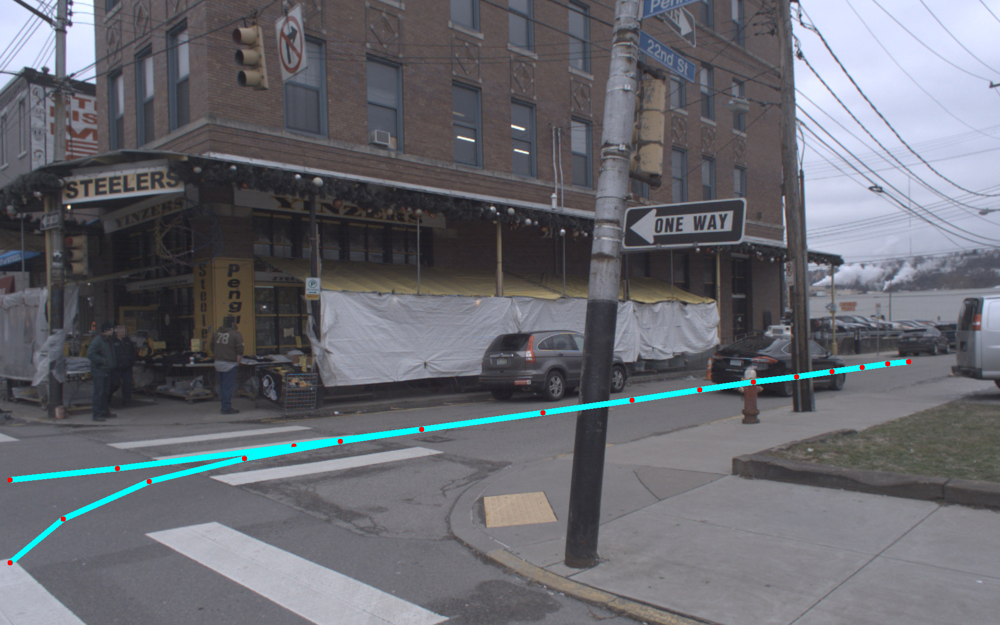

time taken for camera  ring_front_left :  15.520010709762573


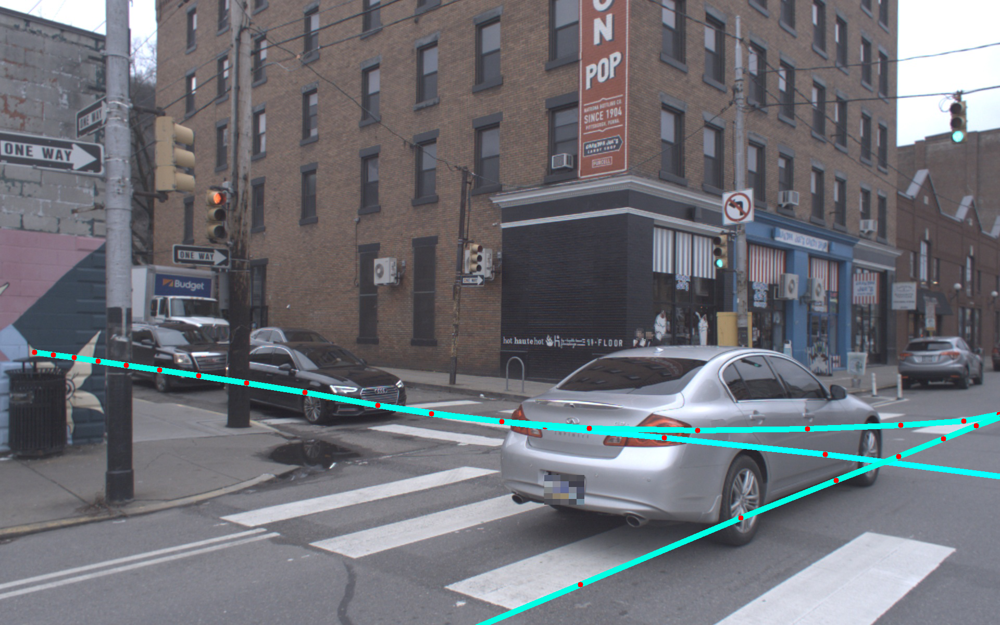

time taken for camera  ring_rear_right :  18.805376768112183


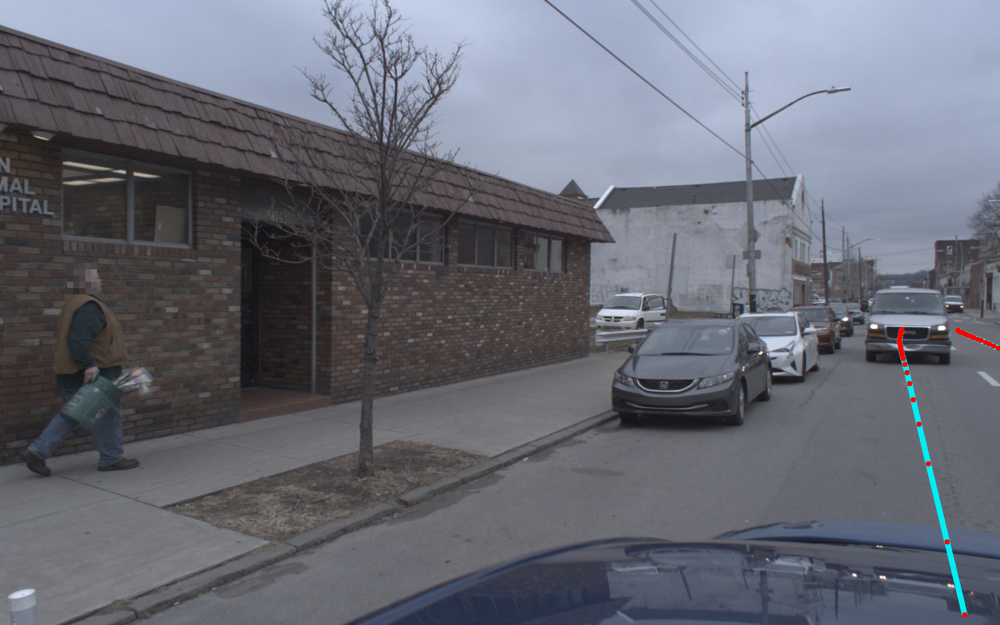

time taken for camera  ring_rear_left :  17.974226236343384


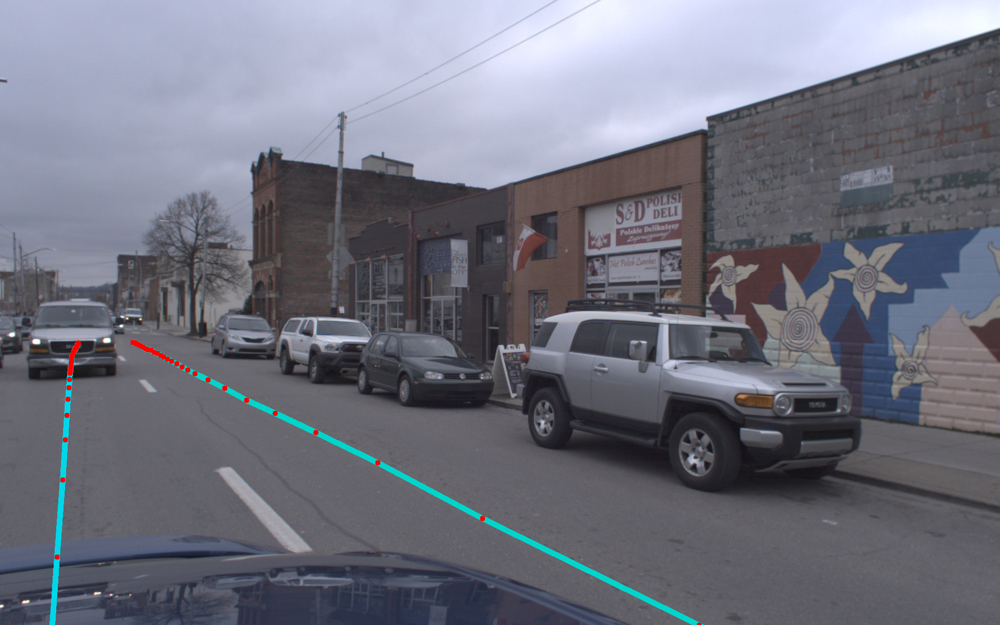

time taken for camera  ring_side_right :  17.980737686157227


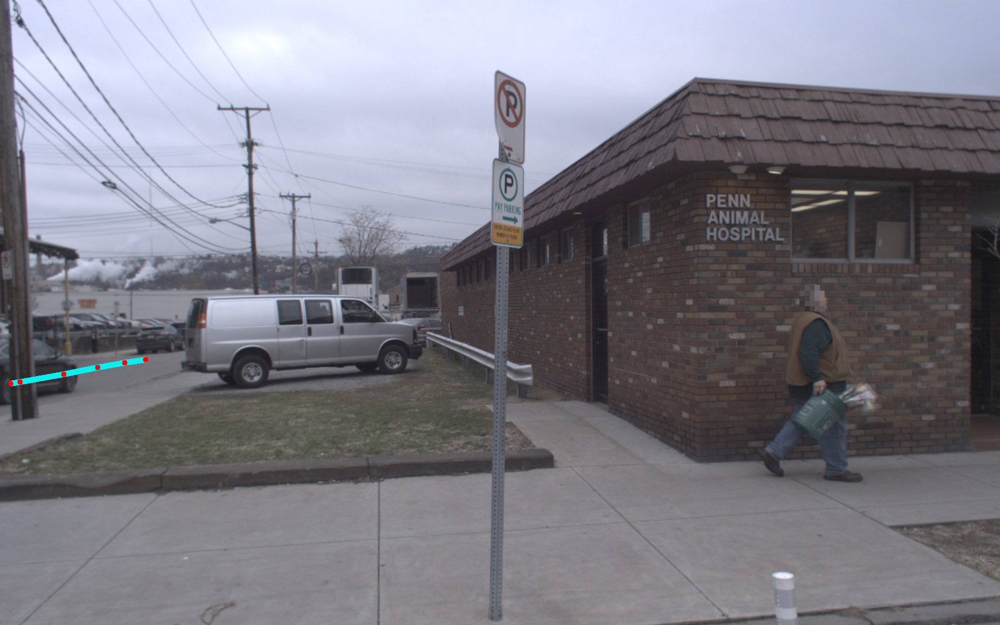

time taken for camera  ring_side_left :  14.663974523544312


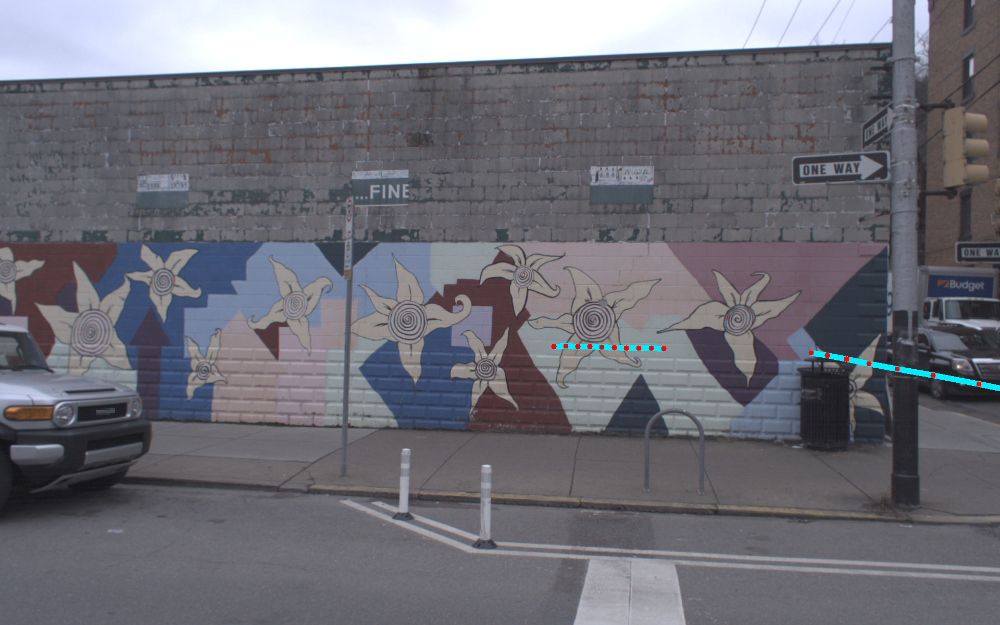

In [5]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
from demo_usage.visualize_30hz_benchmark_data_on_map import DatasetOnMapVisualizer

import argoverse.visualization.visualization_utils as viz_util
from argoverse.utils.frustum_clipping import generate_frustum_planes
from PIL import Image 
from demo_usage.cuboids_to_bboxes import plot_lane_centerlines_in_img
import time

# Map from a bird's-eye-view (BEV)
dataset_dir = tracking_dataset_dir
experiment_prefix = 'visualization_demo'

#if you are running for the first time, or using a new set of logs, this will need to be set False to accumelate the labels again
use_existing_files = True
import logging
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)

domv = DatasetOnMapVisualizer(dataset_dir, experiment_prefix, use_existing_files=use_existing_files, log_id=argoverse_data.current_log)
# camera = 'ring_front_center'

images_dicts = []
lane_ann = []
start = time.time()
ann_id = -1
cameras = ["ring_front_center", "ring_front_right", "ring_front_left",\
            "ring_rear_right", "ring_rear_left", "ring_side_right", "ring_side_left"]
num_ctrl_pts = 10
camera_id = -1            
for camera in cameras:
    camera_id+=1
    calib = argoverse_data.get_calibration(camera = camera)
    planes = generate_frustum_planes(calib.camera_config.intrinsic.copy(), camera)
    for idx in range(156):
        image_id = idx + camera_id*100
        
        city_to_egovehicle_se3 = argoverse_data.get_pose(idx)

        name = argoverse_data.get_image_sync(idx,camera = camera, load=False)
        img = argoverse_data.get_image_sync(idx,camera = camera)
        img_dic = {
            "license": 1,
            "file_name": name,
            "coco_url": "NA",
            "height": img.shape[0],
            "width": img.shape[1],
            "date_captured": "idk",
            "id": image_id
        }
        images_dicts.append(img_dic)

        # display(Image.fromarray(img))
        objects = argoverse_data.get_label_object(idx)

        lidar_pts = argoverse_data.get_lidar(idx)

        img_wlane, lanes, lanes_bird = plot_lane_centerlines_in_img(lidar_pts, city_to_egovehicle_se3, img, city_name, am, calib.camera_config, planes)
        
        
        for lane in lanes:
            ann_id+=1
            if lane==[]:
                continue
            dic = {
                "num_keypoints": len(lane),
                "area": 0,
                "iscrowd": 0,
                "keypoints": [],
                "image_id": image_id,
                "category_id": 1,
                "id": ann_id
            }
            keypoints = []
            
            p = 0
            for c in range(num_ctrl_pts):
                l = lane[p]
                if l[1] != c:
                    for i in range(3):
                        keypoints.append(0)
                else:
                    keypoints.append(l[0][0])
                    keypoints.append(l[0][1])
                    keypoints.append(2)
                    if p<len(lane)-1:
                        p+=1
            
            
            dic["keypoints"] = keypoints
            
            lane_ann.append(dic)
    
    print("time taken for camera ", camera, ": ", time.time()-start)
    display(Image.fromarray(img_wlane))
    start = time.time()

data["images"] = images_dicts
data["annotations"] = lane_ann
# display(Image.fromarray(img_wlane))
# img_vis = viz_util.show_image_with_boxes(img_wlane,objects,calib)
# display(Image.fromarray(img_vis))
# display(Image.fromarray(img_wlane))

In [12]:
len(data["images"])

1092

 --------------------------------------------------------------------------------
 ------------------------- Projecting only ground points in driveable area-------
 --------------------------------------------------------------------------------



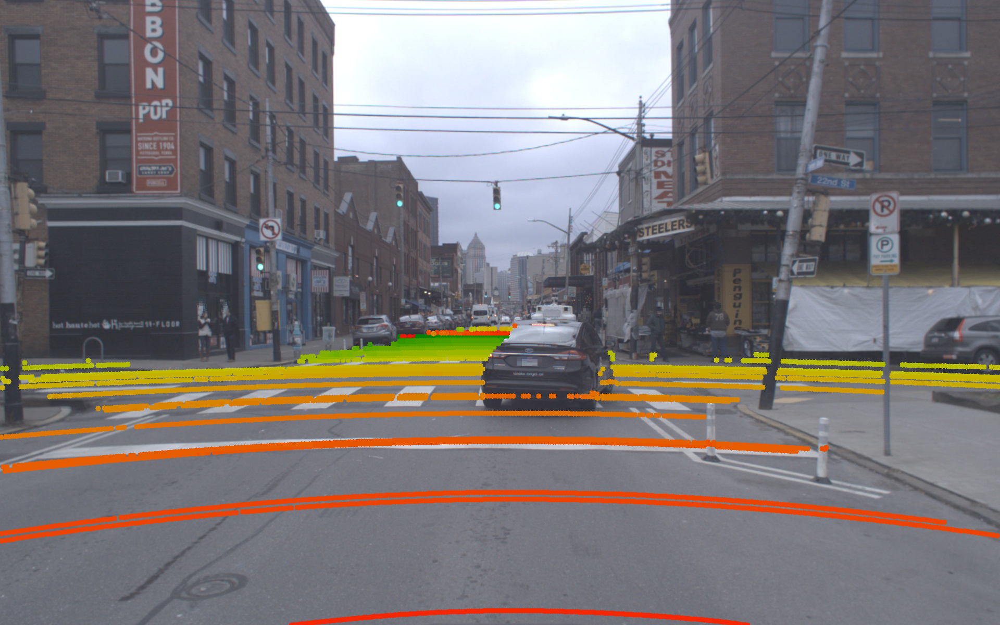

In [15]:
# Using a map to classify LiDAR as ground/non-ground
from argoverse.visualization.ground_visualization import draw_ground_pts_in_image
print(' --------------------------------------------------------------------------------')
print(' ------------------------- Projecting only ground points in driveable area-------')
print(' --------------------------------------------------------------------------------\n')

img = draw_ground_pts_in_image(
            argoverse_data.sync,
            lidar_pts,
            city_to_egovehicle_se3,
            am,
            log_id,
            argoverse_data.lidar_timestamp_list[idx],
            city_name,
            dataset_dir,
            experiment_prefix,
            camera = 'ring_front_center'
        )

display(Image.fromarray(img))